In [1]:
from SimulationEnvironment.Environment import ReachTargetSimulationEnv
import torch.nn as nn
import torch
from torch.autograd import Variable
import torch.nn.functional as F
import torch.optim as optim
from torch.utils import data
from rlbench.backend.observation import Observation
from typing import List
import numpy as np
from torch.utils.data.dataset import Dataset
# Import Relative deps
import sys
from models.Agent import LearningAgent
import logger
import matplotlib.pyplot as plt

In [2]:

class SimpleFullyConnectedPolicyEstimator(nn.Module):
    
    def __init__(self,num_states,num_actions,num_layers=1):
        super(SimpleFullyConnectedPolicyEstimator, self).__init__()
        self.fc0 = nn.Linear(num_states, 200)

        self.layer_names = ['fc'+str(i+1) for i in range(num_layers)]
        for layer_name in self.layer_names:
            setattr(self,layer_name,nn.Linear(200,200))
        self.fc_op = nn.Linear(200, num_actions)

    # x is input to the network.
    def forward(self, x):
        x = F.relu(self.fc0(x))
        for layer_name in self.layer_names:
            layer = getattr(self,layer_name)
            x = F.relu(layer(x))
        x = self.fc_op(x)
        return x


class SimplePolicyDataset(Dataset):
    def __init__(self, final_vector,actions):
        self.final_vector = final_vector
        self.actions = actions

        
    def __getitem__(self, index):
        return (self.final_vector[index], self.actions[index])

    def __len__(self):
        return len(self.final_vector) # of how many examples(images?) you have

class SimpleImmitationLearningAgent(LearningAgent):
    """
    SimpleImmitationLearningAgent
    -----------------------
    Ment for the ReachTarget Task. 

    Slightly Smarter Agent than its predecessor as it will try to eastimate an action given a joint positions + final coordinates as a single vector. 
    This will Not be considering Past actions/states while making these predictions. 
    
    - [joint_positions_1,....joint_position_7,x,y,z] : Tensor Representation
    """
    def __init__(self,learning_rate = 0.01,batch_size=64,num_layers=4):
        super(LearningAgent,self).__init__()
        self.learning_rate = learning_rate
        # action should contain 1 extra value for gripper open close state
        self.neural_network = SimpleFullyConnectedPolicyEstimator(10,8,num_layers=num_layers)
        self.optimizer = optim.SGD(self.neural_network.parameters(), lr=learning_rate, momentum=0.9)
        self.loss_function = nn.SmoothL1Loss()
        self.training_data = None
        agent_name = __class__.__name__+'__Layer__'+str(num_layers)
        self.agent_name = agent_name
        self.logger = logger.create_logger(agent_name)
        self.logger.propagate = 0
        self.input_state = 'joint_positions'
        self.output_action = 'joint_velocities'
        self.data_loader = None
        self.dataset = None
        self.batch_size =batch_size
        self.collect_gradeints = True
        self.gradients = {
            'max':[],
            'avg':[],
            'layer':[]
        }
        self.print_every = 40
        

    def injest_demonstrations(self,demos:List[List[Observation]],**kwargs):
        """
        take demos and make one tensor from
            - joint_positions
            - target_positions
        Output Labels are : Joint velcoities
        """
        # Input State Tensors
        final_vector = self.get_train_vectors(demos)    
        final_torch_tensor = torch.from_numpy(final_vector)
        self.total_train_size = len(final_torch_tensor)
        # Output Action Tensors
        ground_truth_velocities = np.array([getattr(observation,'joint_velocities') for episode in demos for observation in episode]) #
        ground_truth_gripper_positions = np.array([getattr(observation,'gripper_open') for episode in demos for observation in episode])
        ground_truth_gripper_positions = ground_truth_gripper_positions.reshape(len(ground_truth_gripper_positions),1)
        ground_truth = torch.from_numpy(np.concatenate((ground_truth_velocities,ground_truth_gripper_positions),axis=1))
        
        self.logger.info("Creating Tensordata for Pytorch of Size : %s" % (str(final_torch_tensor.size())))
        self.dataset = SimplePolicyDataset(final_torch_tensor, ground_truth)
        self.data_loader = torch.utils.data.DataLoader(self.dataset, batch_size=self.batch_size, shuffle=True)

    def get_train_vectors(self,demos:List[List[Observation]]):
        joint_pos_arr = np.array([getattr(observation,'joint_positions') for episode in demos for observation in episode])
        target_pos_arr = np.array([getattr(observation,'task_low_dim_state') for episode in demos for observation in episode])
        final_vector = np.concatenate((joint_pos_arr,target_pos_arr),axis=1)
        return final_vector

    def set_gradients(self,named_parameters):
        avg_grads = []
        max_grads= []
        layers = []
        for n, p in named_parameters:
            if(p.requires_grad) and ("bias" not in n):
                layers.append(n)
                avg_grads.append(p.grad.abs().mean())
                max_grads.append(p.grad.abs().max())
        self.gradients['max'].append(max_grads)
        self.gradients['avg'].append(avg_grads)
        self.gradients['layer'].append(layers)

    def train_agent(self,epochs:int):
        if not self.dataset:
            raise Exception("No Training Data Set to Train Agent. Please set Training Data using ImmitationLearningAgent.injest_demonstrations")
        
        self.logger.info("Starting Training of Agent ")
        self.neural_network.train()
        final_loss = []
        for epoch in range(epochs):
            running_loss = 0.0
            steps = 0
            for batch_idx, (final_torch_tensor,output) in enumerate(self.data_loader):
                final_torch_tensor,output = Variable(final_torch_tensor),Variable(output) 
                self.optimizer.zero_grad()
                network_pred = self.neural_network(final_torch_tensor.float()) 
                loss = self.loss_function(network_pred,output.float())
                loss.backward()
                if self.collect_gradeints:
                    self.set_gradients(self.neural_network.named_parameters())
                self.optimizer.step()
                running_loss += loss.item()*final_torch_tensor.size(0)
                steps+=1
            if epoch % self.print_every == 0:
                self.logger.info('[%d] loss: %.6f' % (epoch + 1, running_loss / (steps+1)))
            final_loss.append(float(running_loss))
        
        return final_loss

    def predict_action(self, demonstration_episode:List[Observation],**kwargs) -> np.array:
        self.neural_network.eval()
        final_vector = self.get_train_vectors([demonstration_episode])
        final_vector = Variable(torch.from_numpy(final_vector))
        output = self.neural_network(final_vector.float())
        op = output.data.cpu().numpy()
        return op[0] # Because there is only one action as output. 


In [3]:

class FullyConnectedPolicyEstimator(nn.Module):
    
    def __init__(self,num_states,num_actions):
        super(FullyConnectedPolicyEstimator, self).__init__()
        self.fc1 = nn.Linear(num_states, 200)
        self.fc3 = nn.Linear(200, num_actions)

    # x is input to the network.
    def forward(self, x):
        x = F.relu(self.fc1(x))
        x = self.fc3(x)
        return x

class ModularPolicyEstimator(nn.Module):
    
    def __init__(self,action_dims=8):
        super(ModularPolicyEstimator, self).__init__()
        modular_policy_op_dims = 10
        # Define Modular Policy dimes
        self.joint_pos_policy = FullyConnectedPolicyEstimator(7,modular_policy_op_dims)
        self.target_pos_policy = FullyConnectedPolicyEstimator(3,modular_policy_op_dims)

        # Define connecting Fc Linear layers.
        self.fc1 = nn.Linear(20, 200)
        self.fc3 = nn.Linear(200,action_dims)

    def forward(self,joint_pos,target_pos):
        joint_pos_op = self.joint_pos_policy(joint_pos)
        target_pos_op = self.target_pos_policy(target_pos)
        
        # option 1
        # stacked_tensor : shape (batch_size,10+10)
        # Output is combined into a single tensor.
        stacked_tensor = torch.cat((joint_pos_op,target_pos_op),1)
        op = F.relu(self.fc1(stacked_tensor))
        op = self.fc3(op)

        return op


class ModularPolicyDataset(Dataset):
    def __init__(self, joint_pos,target_pos,actions):
        self.joint_pos = joint_pos
        self.target_pos = target_pos
        self.actions = actions

        
    def __getitem__(self, index):
        return (self.joint_pos[index], self.target_pos[index],self.actions[index])

    def __len__(self):
        return len(self.joint_pos) # of how many examples(images?) you have


class ImmitationLearningMutantAgent(LearningAgent):
    """
    ImmitationLearningMutantAgent
    -----------------------
    Ment for the ReachTarget Task. 

    Slightly Smarter Agent than its predecessor as it will try to eastimate an action given a joint positions + final coordinates of the Object. 
    This will Not be considering Past actions/states while making these predictions. 
    
    - Uses a Parent NN which has modular sub NNs which deal with the joint_position and final_coords. 
    - Parent NN will then concat the output on the axis=1
        Eg, 
            x = tensor([[1,2,3]])
            y = tensor([[1,2,3]])
            z  = torch.cat((x,y),1)
            
            z is tensor([[1,2,3,1,2,3]])
    - The concat vector is passed through fully connected layers to finally yeild output vector.
    """
    def __init__(self,learning_rate = 0.01,batch_size=64):
        super(LearningAgent,self).__init__()
        self.learning_rate = learning_rate
        # action should contain 1 extra value for gripper open close state
        self.neural_network = ModularPolicyEstimator()
        self.optimizer = optim.SGD(self.neural_network.parameters(), lr=learning_rate, momentum=0.9)
        self.loss_function = nn.SmoothL1Loss()
        self.training_data = None
        self.agent_name = __class__.__name__
        self.logger = logger.create_logger(__class__.__name__)
        self.logger.propagate = 0
        self.input_state = 'joint_positions'
        self.output_action = 'joint_velocities'
        self.data_loader = None
        self.dataset = None
        self.batch_size =batch_size
        self.collect_gradeints = True
        self.gradients = {
            'max':[],
            'avg':[],
            'layer':[]
        }
        self.print_every = 40 # Prints every 10 epochs

    def injest_demonstrations(self,demos:List[List[Observation]],**kwargs):
        """
        take demos and make two tensors
            - joint_positions
            - target_positions
        Output Labels are : 
        """
        # Input State Tensors
        joint_pos_arr,target_pos_arr = self.get_train_vectors(demos)    
        joint_position_train_vector = torch.from_numpy(joint_pos_arr)
        target_position_train_vector = torch.from_numpy(target_pos_arr)
        self.total_train_size = len(joint_position_train_vector)
        # Output Action Tensors
        ground_truth_velocities = np.array([getattr(observation,'joint_velocities') for episode in demos for observation in episode]) #
        ground_truth_gripper_positions = np.array([getattr(observation,'gripper_open') for episode in demos for observation in episode])
        ground_truth_gripper_positions = ground_truth_gripper_positions.reshape(len(ground_truth_gripper_positions),1)
        ground_truth = torch.from_numpy(np.concatenate((ground_truth_velocities,ground_truth_gripper_positions),axis=1))
        
        self.logger.info("Creating Tensordata for Pytorch of Size : %s %s " % (str(joint_position_train_vector.size()),str(target_position_train_vector.size())))
        self.dataset = ModularPolicyDataset(joint_position_train_vector,target_position_train_vector, ground_truth)
        self.data_loader = torch.utils.data.DataLoader(self.dataset, batch_size=self.batch_size, shuffle=True)

    def get_train_vectors(self,demos:List[List[Observation]]):
        joint_pos_arr = np.array([getattr(observation,'joint_positions') for episode in demos for observation in episode])
        target_pos_arr = np.array([getattr(observation,'task_low_dim_state') for episode in demos for observation in episode])
        return joint_pos_arr,target_pos_arr

    def set_gradients(self,named_parameters):
        avg_grads = []
        max_grads= []
        layers = []
        for n, p in named_parameters:
            if(p.requires_grad) and ("bias" not in n):
                layers.append(n)
                avg_grads.append(p.grad.abs().mean())
                max_grads.append(p.grad.abs().max())
        self.gradients['max'].append(max_grads)
        self.gradients['avg'].append(avg_grads)
        self.gradients['layer'].append(layers)

    def train_agent(self,epochs:int):
        if not self.dataset:
            raise Exception("No Training Data Set to Train Agent. Please set Training Data using ImmitationLearningAgent.injest_demonstrations")
        
        self.logger.info("Starting Training of Agent ")
        self.neural_network.train()
        final_loss = []
        for epoch in range(epochs):
            running_loss = 0.0
            steps = 0
            for batch_idx, (jointpos, targetpos,output) in enumerate(self.data_loader):
                jointpos, targetpos,output = Variable(jointpos), Variable(targetpos),Variable(output) 
                self.optimizer.zero_grad()
                network_pred = self.neural_network(jointpos.float(),targetpos.float()) 
                loss = self.loss_function(network_pred,output.float())
                loss.backward()
                if self.collect_gradeints:
                    self.set_gradients(self.neural_network.named_parameters())
                self.optimizer.step()
                running_loss += loss.item()*jointpos.size(0)
                steps+=1
            if epoch % self.print_every == 0:
                self.logger.info('[%d] loss: %.6f' % (epoch + 1, running_loss / (steps+1)))
            final_loss.append(float(running_loss))
        
        return final_loss

    def predict_action(self, demonstration_episode:List[Observation],**kwargs) -> np.array:
        self.neural_network.eval()
        joint_pos_arr,target_pos_arr = self.get_train_vectors([demonstration_episode])
        joint_pos = Variable(torch.from_numpy(joint_pos_arr))
        target_pos = Variable(torch.from_numpy(target_pos_arr))
        output = self.neural_network(joint_pos.float(),target_pos.float())
        op = output.data.cpu().numpy()
        return op[0] # Because there is only one action as output. 


In [13]:
import datetime 
def plot_grad_figures(agent):
    last_time = datetime.datetime.now()
    figure = plt.figure()    
    for i in range(len(agent.gradients['avg'])):
        curr_time = datetime.datetime.now()
        layers = agent.gradients['layer'][i]
        avg_grads = agent.gradients['avg'][i]
        plt.plot(avg_grads, alpha=0.3, color="b")
        plt.hlines(0, 0, len(avg_grads)+1, linewidth=1, color="k" )
        plt.xticks(range(0,len(avg_grads), 1), layers, rotation="vertical")
        plt.xlim(xmin=0, xmax=len(avg_grads))
        if (curr_time - last_time).total_seconds() > 30:
            print("Completed %d Percentage of injesting to Chart "% ((i/len(agent.gradients['avg']))*100))
            last_time = curr_time

    plt.xlabel("Layers")
    plt.ylabel("average gradient")
    plt.title("Gradient flow  "+ agent.agent_name)
    plt.grid(True)
    return figure

In [5]:
mutant_agent = ImmitationLearningMutantAgent()
simple_agents = [SimpleImmitationLearningAgent(num_layers=i+1) for i in range(3)]
# simple_agent = SimpleImmitationLearningAgent()
curr_env = ReachTargetSimulationEnv(dataset_root='/tmp/rlbench_data',headless=True)
demos = curr_env.get_demos(200,live_demos=False,image_paths_output=True) 

2020-04-08 16:25:36,806 - ReachTargetSimulationEnv - INFO - Creating Demos
2020-04-08 16:25:37,589 - ReachTargetSimulationEnv - INFO - Created Demos
2020-04-08 16:25:37,619 - ReachTargetSimulationEnv - INFO - Environment Shutdown! Create New Instance If u want to start again


In [6]:
mutant_agent.injest_demonstrations(demos)
mutant_agent_loss = mutant_agent.train_agent(100)


2020-04-08 16:25:42,419 - ImmitationLearningMutantAgent - INFO - Creating Tensordata for Pytorch of Size : torch.Size([8084, 7]) torch.Size([8084, 3]) 
2020-04-08 16:25:42,424 - ImmitationLearningMutantAgent - INFO - Starting Training of Agent 
2020-04-08 16:25:43,605 - ImmitationLearningMutantAgent - INFO - [1] loss: 1.986508
2020-04-08 16:26:17,048 - ImmitationLearningMutantAgent - INFO - [41] loss: 0.150612
2020-04-08 16:26:47,371 - ImmitationLearningMutantAgent - INFO - [81] loss: 0.077627
2020-04-08 16:27:04,191 - SimpleImmitationLearningAgent__Layer__1 - INFO - Creating Tensordata for Pytorch of Size : torch.Size([8084, 10])
2020-04-08 16:27:04,220 - SimpleImmitationLearningAgent__Layer__2 - INFO - Creating Tensordata for Pytorch of Size : torch.Size([8084, 10])
2020-04-08 16:27:04,272 - SimpleImmitationLearningAgent__Layer__3 - INFO - Creating Tensordata for Pytorch of Size : torch.Size([8084, 10])
2020-04-08 16:27:04,274 - SimpleImmitationLearningAgent__Layer__1 - INFO - Starti

 Gradient at  12033


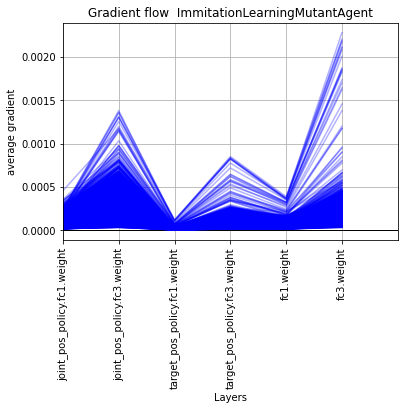

In [12]:
mutant_figure = plot_grad_figures(mutant_agent)
plt.show()

Completed 18 Percentage of injesting to Chart 
Completed 29 Percentage of injesting to Chart 
Completed 37 Percentage of injesting to Chart 
Completed 41 Percentage of injesting to Chart 
Completed 46 Percentage of injesting to Chart 
Completed 49 Percentage of injesting to Chart 
Completed 53 Percentage of injesting to Chart 
Completed 57 Percentage of injesting to Chart 
Completed 60 Percentage of injesting to Chart 
Completed 63 Percentage of injesting to Chart 
Completed 66 Percentage of injesting to Chart 
Completed 69 Percentage of injesting to Chart 
Completed 72 Percentage of injesting to Chart 
Completed 75 Percentage of injesting to Chart 
Completed 78 Percentage of injesting to Chart 
Completed 81 Percentage of injesting to Chart 
Completed 85 Percentage of injesting to Chart 
Completed 88 Percentage of injesting to Chart 
Completed 91 Percentage of injesting to Chart 
Completed 94 Percentage of injesting to Chart 
Completed 97 Percentage of injesting to Chart 


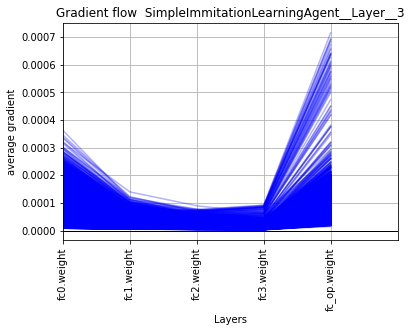

In [17]:
plot_grad_figures(simple_agents[2])
plt.show()

Completed 18 Percentage of injesting to Chart 
Completed 28 Percentage of injesting to Chart 
Completed 36 Percentage of injesting to Chart 
Completed 42 Percentage of injesting to Chart 
Completed 47 Percentage of injesting to Chart 
Completed 51 Percentage of injesting to Chart 
Completed 54 Percentage of injesting to Chart 
Completed 57 Percentage of injesting to Chart 
Completed 60 Percentage of injesting to Chart 
Completed 63 Percentage of injesting to Chart 
Completed 66 Percentage of injesting to Chart 
Completed 69 Percentage of injesting to Chart 
Completed 71 Percentage of injesting to Chart 
Completed 74 Percentage of injesting to Chart 
Completed 76 Percentage of injesting to Chart 
Completed 79 Percentage of injesting to Chart 
Completed 82 Percentage of injesting to Chart 
Completed 85 Percentage of injesting to Chart 
Completed 87 Percentage of injesting to Chart 
Completed 90 Percentage of injesting to Chart 
Completed 93 Percentage of injesting to Chart 
Completed 96 

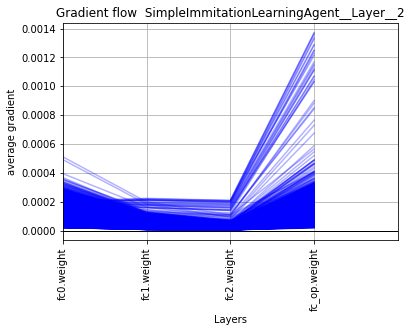

In [18]:
plot_grad_figures(simple_agents[1])
plt.show()

Completed 17 Percentage of injesting to Chart 
Completed 28 Percentage of injesting to Chart 
Completed 37 Percentage of injesting to Chart 
Completed 45 Percentage of injesting to Chart 
Completed 51 Percentage of injesting to Chart 
Completed 57 Percentage of injesting to Chart 
Completed 61 Percentage of injesting to Chart 
Completed 63 Percentage of injesting to Chart 
Completed 66 Percentage of injesting to Chart 
Completed 69 Percentage of injesting to Chart 
Completed 72 Percentage of injesting to Chart 
Completed 74 Percentage of injesting to Chart 
Completed 77 Percentage of injesting to Chart 
Completed 79 Percentage of injesting to Chart 
Completed 82 Percentage of injesting to Chart 
Completed 84 Percentage of injesting to Chart 
Completed 86 Percentage of injesting to Chart 
Completed 89 Percentage of injesting to Chart 
Completed 91 Percentage of injesting to Chart 
Completed 93 Percentage of injesting to Chart 
Completed 96 Percentage of injesting to Chart 
Completed 98 

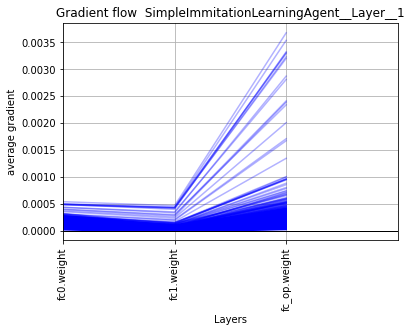

In [19]:
plot_grad_figures(simple_agents[0])
plt.show()